<a href="https://colab.research.google.com/github/NJain121442/course2020/blob/master/18August_SEM_Conv2d_V2_w/o_FC_M0_V1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install kornia
from kornia import filters
import torch.nn as nn
import glob
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
import numpy as np
from torchsummary import summary 
import torchvision
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from PIL import Image

     |████████████████████████████████| 204kB 4.5MB/s 


In [ ]:
#from google.colab import drive 
#drive.mount("/content/drive")

In [2]:
!unzip /content/M0_120_class_images.zip -d /content/
!unzip /content/M0_Test_Data.zip -d /content/

Archive:  /content/M0_120_class_images.zip
   creating: /content/M0_Selected_class_images/
  inflating: /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105326_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105665_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107357_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107695_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_109387_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111079_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111418_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111756_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_113786_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_11421

In [3]:
#Data_path = "/content/Fruits/"
#Data_path = "/content/drive/My Drive/AutoEncoder_training/AutoEncoder_training/"
#Data_path = "/content/drive/My Drive/All_class_images"
Data_path = "/content/M0_Selected_class_images"
File_list = glob.glob(Data_path+'/*.tiff')
Test_Data_path = "/content/M0_Test_Data"

In [ ]:
len(File_list)

120

Lets Resize all images to same size

In [5]:
class CustomDataset(Dataset):
  def __init__(self,path,new_size = 226):
    #self.filelist = glob.glob(path+'/*.jfif')
    self.filelist = glob.glob(path+'/*.tiff')
    self.new_size = new_size

  def __len__(self):
    return len(self.filelist)

  def __getitem__(self, idx):
    temp_filepath = self.filelist[idx]
    temp_image = cv2.imread(temp_filepath)
    temp_image = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)
    temp_image = temp_image/255
    temp_image = torch.Tensor(temp_image)
    temp_image = temp_image.unsqueeze(0)
    return temp_image

In [6]:
Data = CustomDataset(Data_path)
Test_data = CustomDataset(Test_Data_path)
Data[1].shape

torch.Size([1, 504, 504])

In [7]:
class COV2D_AutoEncoder(nn.Module):
    def __init__(self,filters = [64,128,256,128]):
        super(COV2D_AutoEncoder,self).__init__()
        self.enc1 = nn.Conv2d(1,filters[0],kernel_size=3,stride=3)
        self.enc2 = nn.Conv2d(filters[0],filters[1],kernel_size=3,stride=3)
        self.enc3 = nn.Conv2d(filters[1],filters[2],kernel_size=2,stride=3)
        self.enc4 = nn.Conv2d(filters[2],filters[3],kernel_size=3,stride=2)
        self.pool = nn.MaxPool2d(2,2,return_indices=True)
        self.dec1 = nn.ConvTranspose2d(filters[3],filters[2],kernel_size=3,stride=2)
        self.dec2 = nn.ConvTranspose2d(filters[2],filters[1], kernel_size=2, stride=3)  
        self.dec3 = nn.ConvTranspose2d(filters[1],filters[0], kernel_size=3, stride=3)
        self.dec4 = nn.ConvTranspose2d(filters[0] ,1, kernel_size=3, stride=3)
        self.unpool = nn.MaxUnpool2d(2,2,padding=0)

    def forward(self,x):
        x = F.relu(self.enc1(x)) # output will be 168x168x64
        x,indices1 = self.pool(x) #output will be 84x84x64
        x= F.relu(self.enc2(x)) #output will be 28x28x128
        x,indices2 = self.pool(x)   # output will be 14x14x128
        x= F.relu(self.enc3(x)) #output will be 5x5x256
        x= F.relu(self.enc4(x)) #output will be 2x2x512
        Encoded_rep,indices3 = self.pool(x)   # output will be 1x1x512
        x = self.unpool(Encoded_rep,indices3)   # output will be 2x2x512
        x = F.relu(self.dec1(x)) # ouput will be 5x5x256
        x = F.relu(self.dec2(x)) # output will be 14x14x128
        x = self.unpool(x,indices2) #output will be 28x28x128
        x = F.relu(self.dec3(x)) # output will be 84x84x64
        x = self.unpool(x,indices1) #output will be 28x28x128
        x = torch.sigmoid(self.dec4(x)) # output will be 504x504x1
        return x,Encoded_rep.view(-1,128)

**Lets write the first Auto encoder **

In [8]:
net = COV2D_AutoEncoder()
print(net)
if torch.cuda.is_available():
    net.cuda()
summary(net,input_size=(1,504,504),batch_size=2)

COV2D_AutoEncoder(
  (enc1): Conv2d(1, 64, kernel_size=(3, 3), stride=(3, 3))
  (enc2): Conv2d(64, 128, kernel_size=(3, 3), stride=(3, 3))
  (enc3): Conv2d(128, 256, kernel_size=(2, 2), stride=(3, 3))
  (enc4): Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (dec1): ConvTranspose2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
  (dec2): ConvTranspose2d(256, 128, kernel_size=(2, 2), stride=(3, 3))
  (dec3): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(3, 3))
  (dec4): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(3, 3))
  (unpool): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2), padding=(0, 0))
)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [2, 64, 168, 168]             640
         MaxPool2d-2  [[-1, 64, 84, 84], [-1, 64, 84, 84]]               0
            Conv2d-3       

In [9]:
train_loader = DataLoader(Data,batch_size=2)

In [10]:
#from torch.optim.lr_scheduler import ReduceLROnPlateau
loss_func = nn.MSELoss()
#loss_func = nn.L1Loss()
optimizer = optim.Adam(net.parameters(), lr=0.0001) 
#optimizer = optim.SGD(net.parameters(), lr=0.01) 
#scheduler = ReduceLROnPlateau(optimizer, 'min')


Training the Auto encoder

In [11]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

n_epochs = 200

if torch.cuda.is_available():
    net.cuda()
total_loss = []

epoch_loss = 0
net.train()
for epoch in tqdm(range(n_epochs)):
    print("current epoch is:",epoch)
    epoch_loss = 0
    for x in train_loader:
        mse_loss = 0
        loss_der = 0
        if torch.cuda.is_available():
          x = x.cuda()
        optimizer.zero_grad()
        prediction = net(x)
        SpatialGradient = filters.SpatialGradient()
        loss_der = loss_func(SpatialGradient(prediction[0]), SpatialGradient(x))
        mse_loss = loss_func(prediction[0], x) # <-- note that i'm using the input as the target
        (mse_loss+loss_der).backward()
        #mse_loss.backward()
        optimizer.step()
        epoch_loss = epoch_loss + mse_loss.item() + loss_der.item()
        #scheduler.step(epoch_loss)
        
    #clear_output(wait=True)
    total_loss.append(epoch_loss)
    print('Loss Per epoch: ',epoch_loss)

current epoch is: 0
Loss Per epoch:  3.9125790871330537
current epoch is: 1
Loss Per epoch:  3.882497991202399
current epoch is: 2
Loss Per epoch:  3.8267775962594897
current epoch is: 3
Loss Per epoch:  3.784736688598059
current epoch is: 4
Loss Per epoch:  3.742132211336866
current epoch is: 5
Loss Per epoch:  3.6981140947900712
current epoch is: 6
Loss Per epoch:  3.6541376993991435
current epoch is: 7
Loss Per epoch:  3.611478042206727
current epoch is: 8
Loss Per epoch:  3.5686411428032443
current epoch is: 9
Loss Per epoch:  3.5241798697970808
current epoch is: 10
Loss Per epoch:  3.4816236594924703
current epoch is: 11
Loss Per epoch:  3.444209997658618
current epoch is: 12
Loss Per epoch:  3.406062380759977
current epoch is: 13
Loss Per epoch:  3.366233156179078
current epoch is: 14
Loss Per epoch:  3.3326954452786595
current epoch is: 15
Loss Per epoch:  3.2931131639052182
current epoch is: 16
Loss Per epoch:  3.260972340358421
current epoch is: 17
Loss Per epoch:  3.230023743

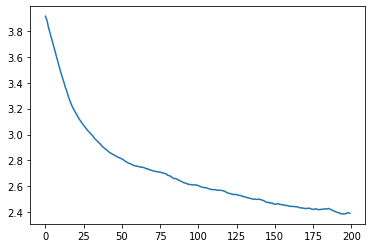

In [12]:
import matplotlib.pyplot as plt
plt.plot(total_loss)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


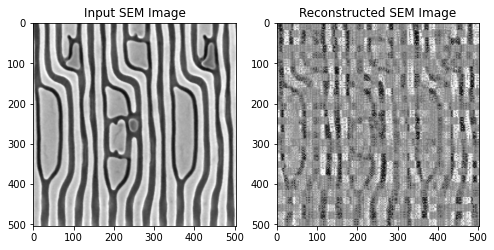

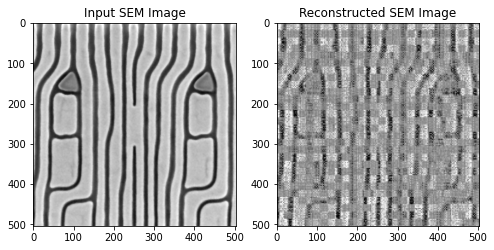

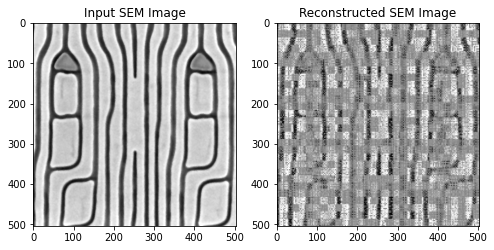

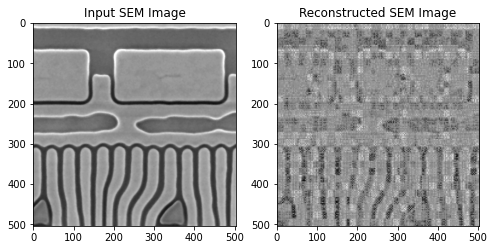

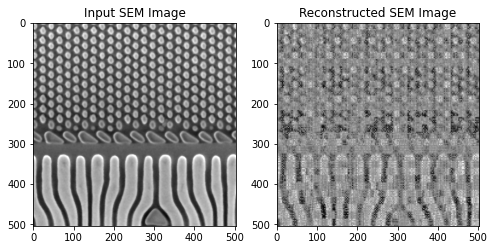

...

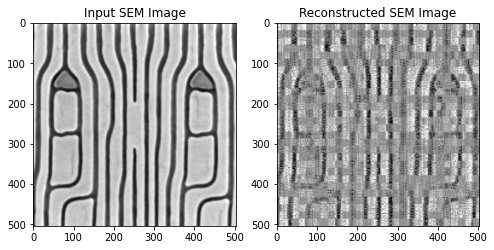

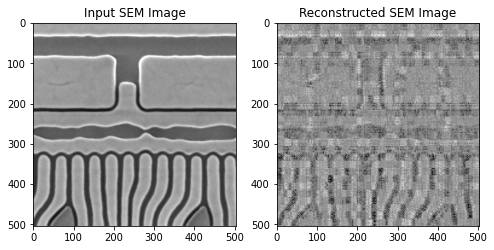

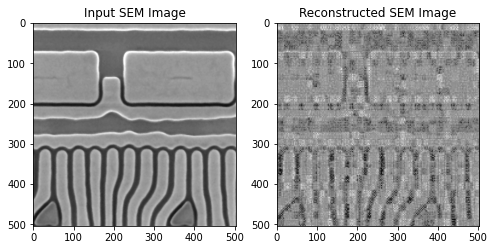

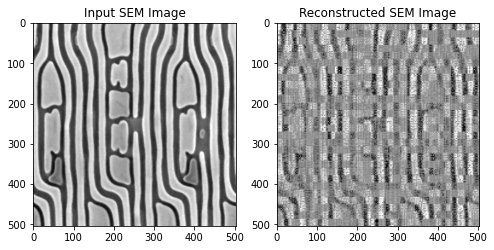

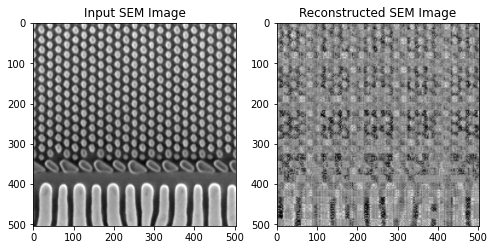

In [13]:
net.cpu()
net.eval()
counter = 0
for i in range(60):
    counter = counter + 1
    fig,ax = plt.subplots(1,2,figsize=(8,4))
    x = Data[i]
    input_img = x[0]
    #print(input_img)
    model_pred = net(x.unsqueeze(0))[0].cpu().data.numpy()[0][0]
    #print(model_pred.shape)
    ax[0].set_title('Input SEM Image',fontsize=12)
    ax[1].set_title('Reconstructed SEM Image',fontsize=12)
    ax[0].imshow(input_img,cmap='gray',vmin=0,vmax=1)
    ax[1].imshow(model_pred,cmap='gray',vmin=0,vmax=1)


Extract Latent representation from Encoder 

Do Clustering and calculate Silhouette Score

In [14]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn import preprocessing
Attributes = np.empty([len(Data),128])
#print(Attributes.shape)
for i,x in enumerate(Data):
  Temp_results = net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes = (Temp_results[1]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes[i] = Temp_Attributes
  #print(Attributes[i].shape)
#print(Attributes.shape)

Attributes_Test = np.empty([len(Test_data),128])
#print(Attributes.shape)
for i,x in enumerate(Test_data):
  Temp_results1 = net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes1 = (Temp_results1[1]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes_Test[i] = Temp_Attributes1
  #print(Attributes[i].shape)
#print(Attributes.shape)

In [15]:
from sklearn.feature_selection import VarianceThreshold
k=7
Attributes_scaled = preprocessing.scale(Attributes)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
selector = VarianceThreshold()
Attributes_scaled = selector.fit_transform(Attributes_scaled)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes_scaled)
Clustering_labels = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes_scaled,Clustering_labels,metric='euclidean')
print(Score)
sample_score = silhouette_samples(Attributes_scaled,Clustering_labels,metric='euclidean')
#print(sample_score)


(120, 128)
[1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0.
 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0.
 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1.
 0. 1. 1. 1. 1. 0. 1. 0.]
(120, 86)
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[1 3 4 2 0 3 1 3 2 6 3 4 3 0 1 1 2 5 3 3 4 2 2 6 2 6 4 2 4 1 5 5 1 5 4 2 0
 3 3 4 4 6 1 2 4 1 2 3 1 1 4 3 2 3 4 4 2 2 3 5 2 3 4 1 3 4 5 6 0 2 4 3 0 3
 0 4 4 5 1 2 3 2 1 5 3 6 5 3 3 2 0 0 3 1 2 6 1 4 1 0 6 4 3 0 4 3 1 2 1 3 2
 2 4 0 1 4 6 6 2 4]
0.27982708074225227


In [17]:
#On Test Data
Attributes_Test_scaled = preprocessing.scale(Attributes_Test)
kmeans_Test = KMeans(n_clusters=k,random_state=0).fit(Attributes_Test_scaled)
Clustering_labels_Test = kmeans_Test.labels_
print(Clustering_labels_Test)
Score_Test = silhouette_score(Attributes_Test_scaled,Clustering_labels_Test,metric='euclidean')
print(Score_Test)
sample_score_Test = silhouette_samples(Attributes_Test_scaled,Clustering_labels_Test,metric='euclidean')

[2 0 1 6 2 2 1 3 2 2 4 2 1 5 1 1 2 6 6 6 4 1 1 6 1 4 1 5 0 6 1 1 1 4 6 2 1
 1 0 5 3 6 1 4 0 6 6 3 3 6]
0.3767467574727607


In [18]:
max(sample_score)

0.5650155337862665

Find Optimal K using Silhouette score

In [20]:
import pandas as pd 
column_names = ["Image","Label","Score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels[i]
  df['Score'][i] = sample_score[i]
  #print(input_img)
  df
df_Test = pd.DataFrame(columns = column_names,index=np.arange(len(Test_data)))
df_Test['Image'][48]
for i,x in enumerate(Test_data):
  df_Test['Image'][i] = (x[0]).data.numpy()
  df_Test['Label'][i] = Clustering_labels_Test[i]
  df_Test['Score'][i] = sample_score_Test[i]
  #print(input_img)
  df_Test

In [21]:
df= df.sort_values('Label',ignore_index=True)
print(df)
df['Image'][110]
df_Test= df_Test.sort_values('Label',ignore_index=True)
print(df)
df['Image'][110]

                                                 Image Label       Score
0    [[0.64705884, 0.64705884, 0.6431373, 0.6313726...     0    0.304419
1    [[0.38431373, 0.42745098, 0.5058824, 0.6078431...     0    0.108683
2    [[0.8745098, 0.8745098, 0.8666667, 0.8, 0.6705...     0    0.455258
3    [[0.81960785, 0.8235294, 0.827451, 0.83137256,...     0    0.396258
4    [[0.72156864, 0.7176471, 0.7176471, 0.7294118,...     0 -0.00979004
..                                                 ...   ...         ...
115  [[0.5764706, 0.57254905, 0.5647059, 0.5568628,...     6    0.241083
116  [[0.6666667, 0.65882355, 0.64705884, 0.6196078...     6    0.193593
117  [[0.6627451, 0.6627451, 0.6509804, 0.6156863, ...     6    0.156412
118  [[0.65882355, 0.64705884, 0.63529414, 0.623529...     6    0.322542
119  [[0.27058825, 0.25882354, 0.24313726, 0.231372...     6   0.0885023

[120 rows x 3 columns]
                                                 Image Label       Score
0    [[0.64705884, 0.647058

array([[0.5254902 , 0.5254902 , 0.5254902 , ..., 0.5411765 , 0.53333336,
        0.5294118 ],
       [0.52156866, 0.5176471 , 0.5176471 , ..., 0.5411765 , 0.53333336,
        0.5294118 ],
       [0.5137255 , 0.5137255 , 0.50980395, ..., 0.5411765 , 0.5294118 ,
        0.5254902 ],
       ...,
       [0.6431373 , 0.6392157 , 0.6392157 , ..., 0.21568628, 0.27058825,
        0.30980393],
       [0.6627451 , 0.65882355, 0.654902  , ..., 0.21176471, 0.27450982,
        0.3254902 ],
       [0.67058825, 0.6666667 , 0.65882355, ..., 0.21176471, 0.27450982,
        0.32941177]], dtype=float32)

120


<function matplotlib.pyplot.show>

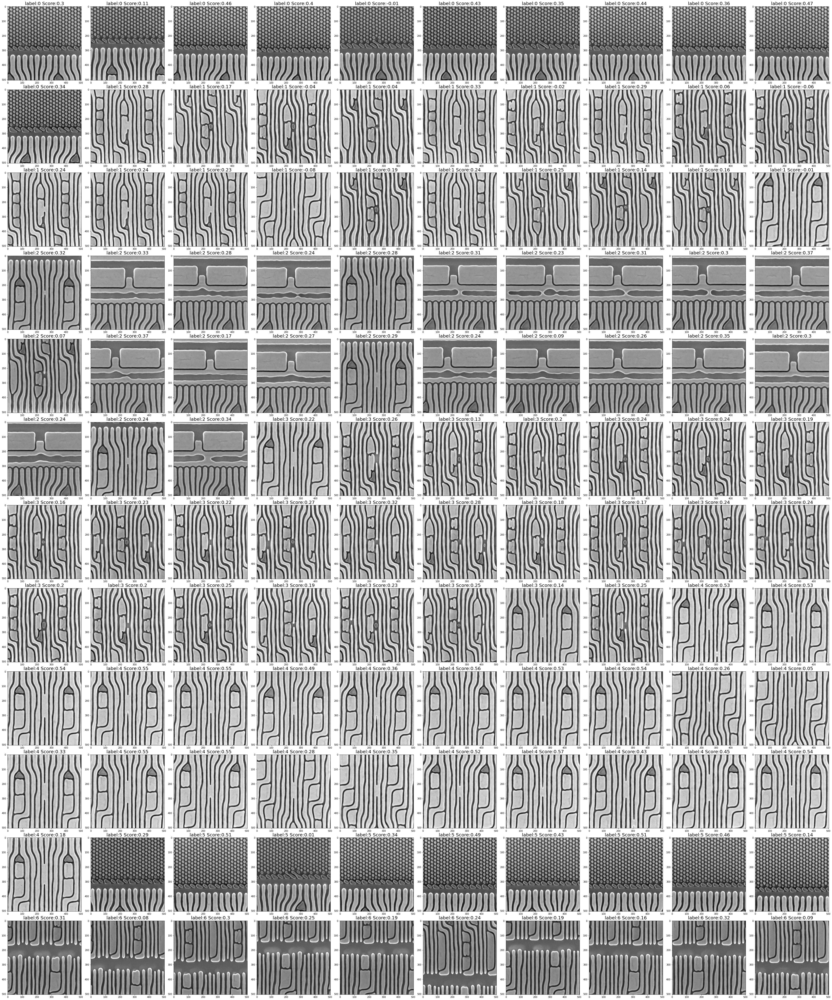

In [22]:
ncols = 10
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [50, 60]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['Score'][i],2)),fontsize =20)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

120


<function matplotlib.pyplot.show>

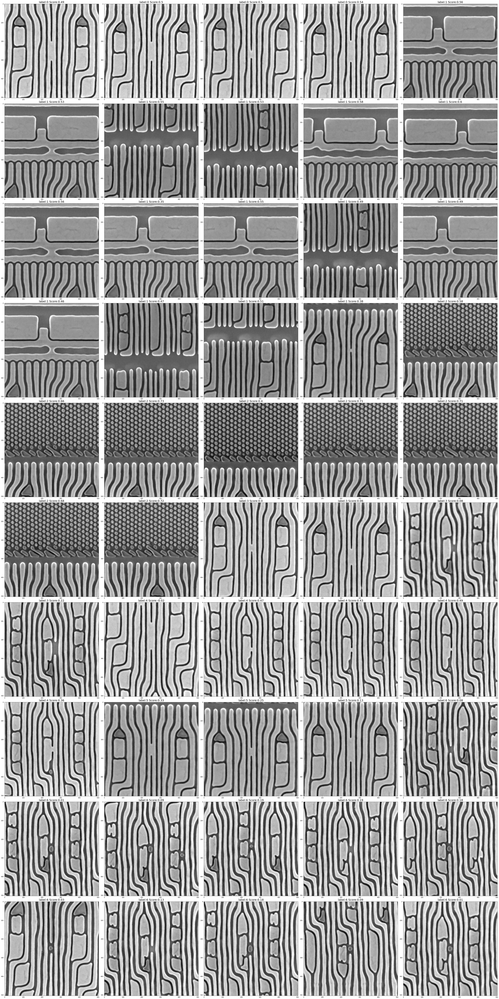

In [24]:
#Plot test Data
ncols = 5
print(len(Data))
nrows = int(len(Test_data)/ncols)
figsize = [50, 100]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Test_data):
  input_img1 = df_Test['Image'][i]
  axi[i].set_title("label:"+str(df_Test['Label'][i])+" "+"Score:"+str(round(df_Test['Score'][i],2)),fontsize =20)
  axi[i].imshow(input_img1,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

In [ ]:
torch.save(net.state_dict(), '/content/model.pt')

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
[0.53769602 0.48975109 0.31803759 0.3289969  0.27376662 0.31401121
 0.28551216 0.29451505 0.26650719 0.26842423 0.26148291 0.2556767
 0.251988   0.23664058 0.25013444 0.23080531 0.22819634 0.22397446
 0.23783912 0.23152842]
[4045.0346531602167, 3027.647597170493, 2517.54430756098, 2283.687574312566, 2103.216307480795, 1953.6630027512497, 1762.5325699641771, 1603.8005841174797, 1527.263080538737, 1438.4484298465063, 1379.4224329307215, 1299.5707480542765, 1257.401977541096, 1204.41073567644, 1177.6154121339407, 1116.1242931276379, 1086.9623280087944, 1063.138739282661, 996.7330327651064, 961.2008170360332]
2


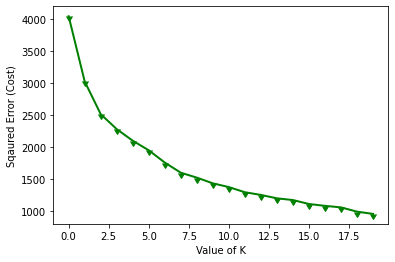

In [ ]:
cost = []
k_range = 20
Score = np.empty(20)
for k in range(k_range):
  print(k)
  kmeans = KMeans(n_clusters=k+2,random_state=0).fit(Attributes_scaled)
  cost.append(kmeans.inertia_)
  Clustering_labels_k = kmeans.labels_
  Score[k] = silhouette_score(Attributes_scaled,Clustering_labels_k,metric='euclidean')
print(Score)
print(cost)
Max_score_k = np.argmax(Score) + 2
print(Max_score_k)
plt.plot(cost, color ='g', linewidth ='2',marker = 11) 
plt.xlabel("Value of K") 
plt.ylabel("Sqaured Error (Cost)") 
plt.show() # clear the plot 
